In [1]:
import tensorflow as tf
from tensorflow.keras.layers import GlobalAveragePooling2D,Dense,Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPool2D, ZeroPadding2D
from tensorflow.keras.layers import BatchNormalization
from tensorflow.keras.models import Model, Sequential
from tensorflow import keras    

2024-04-04 03:30:13.008673: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-04 03:30:13.131656: I external/local_tsl/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-04-04 03:30:13.483347: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-04 03:30:15.888872: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:

from tensorflow.keras.applications import MobileNetV2

In [3]:
img_width,img_height=224,224

model=MobileNetV2(weights='imagenet',
                include_top=False,
                input_shape=(img_height,img_width,3)
                )

In [4]:
for (i,layer) in enumerate(model.layers):
    print(f"{i} {layer.__class__.__name__} {layer.trainable}")

0 InputLayer True
1 Conv2D True
2 BatchNormalization True
3 ReLU True
4 DepthwiseConv2D True
5 BatchNormalization True
6 ReLU True
7 Conv2D True
8 BatchNormalization True
9 Conv2D True
10 BatchNormalization True
11 ReLU True
12 ZeroPadding2D True
13 DepthwiseConv2D True
14 BatchNormalization True
15 ReLU True
16 Conv2D True
17 BatchNormalization True
18 Conv2D True
19 BatchNormalization True
20 ReLU True
21 DepthwiseConv2D True
22 BatchNormalization True
23 ReLU True
24 Conv2D True
25 BatchNormalization True
26 Add True
27 Conv2D True
28 BatchNormalization True
29 ReLU True
30 ZeroPadding2D True
31 DepthwiseConv2D True
32 BatchNormalization True
33 ReLU True
34 Conv2D True
35 BatchNormalization True
36 Conv2D True
37 BatchNormalization True
38 ReLU True
39 DepthwiseConv2D True
40 BatchNormalization True
41 ReLU True
42 Conv2D True
43 BatchNormalization True
44 Add True
45 Conv2D True
46 BatchNormalization True
47 ReLU True
48 DepthwiseConv2D True
49 BatchNormalization True
50 ReLU True

In [5]:
for layer in model.layers:
    layer.trainable=False

In [6]:
for (i,layer) in enumerate(model.layers):
    print(f"{i} {layer.__class__.__name__} {layer.trainable}")

0 InputLayer False
1 Conv2D False
2 BatchNormalization False
3 ReLU False
4 DepthwiseConv2D False
5 BatchNormalization False
6 ReLU False
7 Conv2D False
8 BatchNormalization False
9 Conv2D False
10 BatchNormalization False
11 ReLU False
12 ZeroPadding2D False
13 DepthwiseConv2D False
14 BatchNormalization False
15 ReLU False
16 Conv2D False
17 BatchNormalization False
18 Conv2D False
19 BatchNormalization False
20 ReLU False
21 DepthwiseConv2D False
22 BatchNormalization False
23 ReLU False
24 Conv2D False
25 BatchNormalization False
26 Add False
27 Conv2D False
28 BatchNormalization False
29 ReLU False
30 ZeroPadding2D False
31 DepthwiseConv2D False
32 BatchNormalization False
33 ReLU False
34 Conv2D False
35 BatchNormalization False
36 Conv2D False
37 BatchNormalization False
38 ReLU False
39 DepthwiseConv2D False
40 BatchNormalization False
41 ReLU False
42 Conv2D False
43 BatchNormalization False
44 Add False
45 Conv2D False
46 BatchNormalization False
47 ReLU False
48 DepthwiseCon

In [7]:
def add_layer_at_bottom(bottom_model, num_classes):
    top_model = bottom_model.output
    top_model = GlobalAveragePooling2D()(top_model)
    top_model = Dense(1024,activation='relu')(top_model)
    top_model = Dense(1024,activation='relu')(top_model)
    top_model = Dense(512,activation='relu')(top_model)
    top_model = Dense(num_classes,activation='softmax')(top_model)
    return top_model

## Data Prep

In [8]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [9]:
train_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/training_dataset'
val_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset' 


In [10]:
# from tensorflow.keras.layers.preprocessing.image_preprocessing import HORIZONTAL

train_datagen=ImageDataGenerator(rescale=1./255,
                                 rotation_range=45,
                                 width_shift_range=0.3,
                                 height_shift_range=0.3,
                                 horizontal_flip=True,
                                 fill_mode='nearest')

val_datagen=ImageDataGenerator(rescale=1./255)

In [11]:
batch_size=32

In [12]:
train_generator=train_datagen.flow_from_directory(train_data_dir,
                                                  target_size=(img_height,img_width),
                                                  batch_size=batch_size,
                                                  class_mode='categorical')

val_generator=val_datagen.flow_from_directory(val_data_dir,
                                              target_size=(img_height,img_width),
                                              batch_size=batch_size,
                                              class_mode='categorical')


Found 312 images belonging to 13 classes.
Found 78 images belonging to 13 classes.


In [13]:
train_class_names = set()
num_train_samples=0
for i in train_generator.filenames:
    train_class_names.add(i.split('/')[0])
    num_train_samples+=1
print(num_train_samples)
train_class_names

312


{'Aloe_Vera',
 'Amla',
 'Ashoka',
 'Ashwagandha',
 'Bael',
 'Cinnamon',
 'Henna',
 'Lavender',
 'Marigold',
 'Neem',
 'Peppermint',
 'Tulsi',
 'Turmeric'}

In [14]:
val_class_names = set()
num_val_samples=0
for i in val_generator.filenames:
    val_class_names.add(i.split('/')[0])
    num_val_samples+=1
print(num_val_samples)
val_class_names

78


{'Aloe_Vera',
 'Amla',
 'Ashoka',
 'Ashwagandha',
 'Bael',
 'Cinnamon',
 'Henna',
 'Lavender',
 'Marigold',
 'Neem',
 'Peppermint',
 'Tulsi',
 'Turmeric'}

In [15]:
num_classes=len(train_generator.class_indices)
print(num_classes)
FC_head=add_layer_at_bottom(model,
                            num_classes)

main_model=Model(inputs=model.input,
                 outputs=FC_head)

main_model.summary()

13


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1 (Conv2D)      │ (None, 112, 112,  │        864 │ input_layer[0][0] │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bn_Conv1            │ (None, 112, 112,  │        128 │ Conv1[0][0]       │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ Conv1_relu (ReLU)   │ (None, 112, 112,  │          0 │ bn_Conv1[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        288 │ Conv1_relu[0][0]  │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │        128 │ expanded_conv_de… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_dept… │ (None, 112, 112,  │          0 │ expanded_conv_de… │
│ (ReLU)              │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │        512 │ expanded_conv_de… │
│ (Conv2D)            │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expanded_conv_proj… │ (None, 112, 112,  │         64 │ expanded_conv_pr… │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand      │ (None, 112, 112,  │      1,536 │ expanded_conv_pr… │
│ (Conv2D)            │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_BN   │ (None, 112, 112,  │        384 │ block_1_expand[0… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_expand_relu │ (None, 112, 112,  │          0 │ block_1_expand_B… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_pad         │ (None, 113, 113,  │          0 │ block_1_expand_r… │
│ (ZeroPadding2D)     │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise   │ (None, 56, 56,    │        864 │ block_1_pad[0][0] │
│ (DepthwiseConv2D)   │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │        384 │ block_1_depthwis… │
│ (BatchNormalizatio… │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_depthwise_… │ (None, 56, 56,    │          0 │ block_1_depthwis… │
│ (ReLU)              │ 96)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block_1_project     │ (None, 56, 56,    │      2,304 │ block_1_depthwis

 Total params: 5,150,797 (19.65 MB)

 Trainable params: 2,892,813 (11.04 MB)

 Non-trainable params: 2,257,984 (8.61 MB)

# Training

In [16]:
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

In [17]:

checkpoint = ModelCheckpoint("Model.keras",
                             monitor='val_loss',
                             mode='min',
                             save_best_only=True,verbose=1)

earlystop = EarlyStopping(monitor='val_loss',
                          min_delta=0,
                          patience=2,
                          verbose=1,
                          restore_best_weights=True)

callbacks=[checkpoint,earlystop]

main_model.compile(loss='categorical_crossentropy',
                   optimizer=RMSprop(learning_rate=0.001),
                   metrics=['accuracy'])

epochs=25

batch_size = 32

history = main_model.fit(train_generator,
                         steps_per_epoch=num_train_samples//batch_size,
                         epochs=epochs,
                         callbacks=callbacks,
                         validation_data=val_generator,
                         validation_steps=num_val_samples//batch_size)



Epoch 1/25


/home/atinsharma/.local/lib/python3.12/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:120: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-04-04 03:30:36.005520: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 51380224 exceeds 10% of free system memory.
2024-04-04 03:30:36.126706: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 51380224 exceeds 10% of free system memory.
2024-04-04 03:30:36.210467: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 154140672 exceeds 10% of free system memory.
2024-04-04 03:30:36.332345: W external/local_tsl/tsl/framework/cpu_allocator_impl.cc:83] Allocation of 156905472 exceeds 10% of free system memory.
2024-04-04 03:30:36.46859

9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.0858 - loss: 4.8978
Epoch 1: val_loss improved from inf to 2.34308, saving model to Model.keras
9/9 ━━━━━━━━━━━━━━━━━━━━ 30s 2s/step - accuracy: 0.0868 - loss: 4.8148 - val_accuracy: 0.3594 - val_loss: 2.3431
Epoch 2/25
1/9 ━━━━━━━━━━━━━━━━━━━━ 7s 996ms/step - accuracy: 0.1875 - loss: 2.3955

2024-04-04 03:30:53.898869: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]
/usr/lib64/python3.12/contextlib.py:158: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self.gen.throw(value)



Epoch 2: val_loss improved from 2.34308 to 1.16170, saving model to Model.keras


2024-04-04 03:30:54.531518: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 196ms/step - accuracy: 0.1875 - loss: 1.3308 - val_accuracy: 0.2143 - val_loss: 1.1617
Epoch 3/25
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.3293 - loss: 2.0368
Epoch 3: val_loss did not improve from 1.16170
9/9 ━━━━━━━━━━━━━━━━━━━━ 39s 2s/step - accuracy: 0.3274 - loss: 2.0384 - val_accuracy: 0.4531 - val_loss: 1.6823
Epoch 4/25
1/9 ━━━━━━━━━━━━━━━━━━━━ 13s 2s/step - accuracy: 0.4062 - loss: 1.7357

2024-04-04 03:31:36.281063: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]



Epoch 4: val_loss did not improve from 1.16170
9/9 ━━━━━━━━━━━━━━━━━━━━ 3s 100ms/step - accuracy: 0.4062 - loss: 0.9643 - val_accuracy: 0.2143 - val_loss: 1.2095
Epoch 4: early stopping
Restoring model weights from the end of the best epoch: 2.


2024-04-04 03:31:37.019072: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
	 [[{{node IteratorGetNext}}]]


In [18]:
import matplotlib.pyplot as plt

<function matplotlib.pyplot.show(close=None, block=None)>

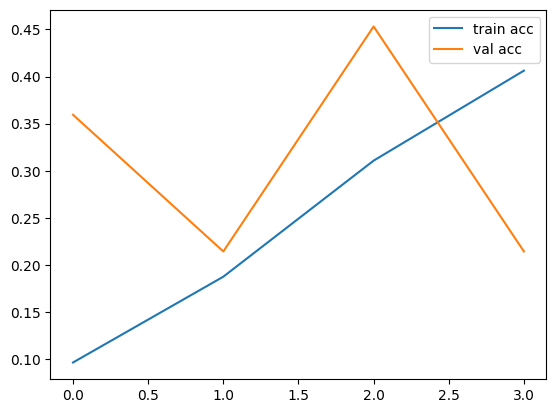

In [19]:
#accuracy
plt.plot(history.history['accuracy'], label= 'train acc')
plt.plot(history.history['val_accuracy'], label= 'val acc')
plt.legend()
# plt.saveig('vcc-acc-rps-1.png')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

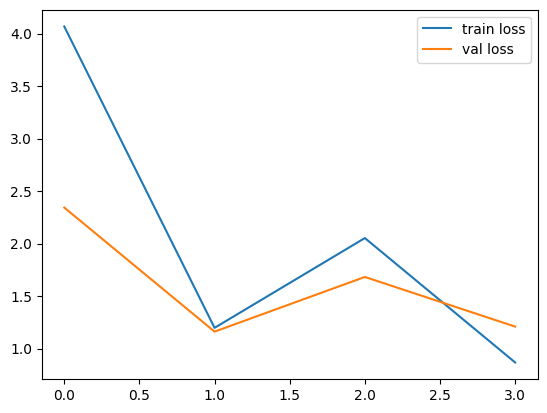

In [20]:
#loss
plt.plot(history.history['loss'], label= 'train loss')
plt.plot(history.history['val_loss'], label= 'val loss')
plt.legend()
# plt.saveig('vcc-loss-rps-1.png')
plt.show

## Inference

In [21]:
# pip install opencv-python

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
[[0.04817916 0.16409534 0.03475703 0.07940859 0.06534681 0.084593
  0.0370758  0.02586999 0.04466994 0.16370599 0.1581986  0.05768233
  0.03641746]]


'Amla'

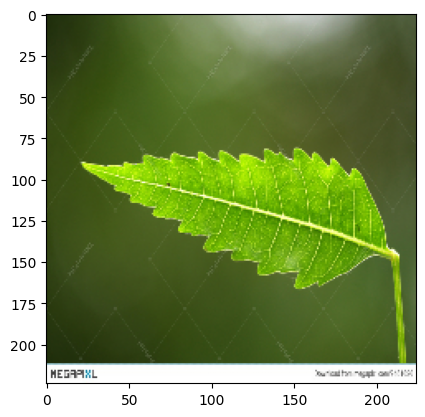

In [22]:
import cv2
out=['Aloe_Vera',
 'Amla',
 'Ashoka',
 'Ashwagandha',
 'Bael',
 'Cinnamon',
 'Henna',
 'Lavender',
 'Marigold',
 'Neem',
 'Peppermint',
 'Tulsi',
 'Turmeric'
 ]
img=cv2.imread("/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset/Neem/images (26).jpg")
img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
img=cv2.resize(img,(224,224))
img=img/255.
import matplotlib.pyplot as plt
plt.imshow(img)
img=img.reshape(1,224,224,3)
import numpy as np
res=main_model.predict(img)
print(res)
out[np.argmax(res)]

In [38]:
# import tensorflow as tf
# from tensorflow.keras.models import load_model

# # Load your Keras functional model
# model = load_model('Model.keras')

# # Create a TFLite converter
# converter = tf.lite.TFLiteConverter.from_keras_model(model)

# # Set optimization and supported ops
# converter.optimizations = [tf.lite.Optimize.DEFAULT]
# converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]

# # Set input and output tensor shapes
# input_tensor = model.inputs[0]
# output_tensor = model.outputs[0]

# input_shape = input_tensor.shape
# output_shape = output_tensor.shape

# # Set input and output types for inference
# converter.inference_input_type = tf.int8
# converter.inference_output_type = tf.int8

# # Quantize input and output tensors manually
# def representative_dataset():
#     yield [tf.random.uniform(input_shape)]
# converter.representative_dataset = representative_dataset
# converter.target_spec.supported_ops = [tf.lite.OpsSet.TFLITE_BUILTINS_INT8]
# converter.inference_input_type = tf.int8
# converter.inference_output_type = tf.int8

# # Set input and output shapes in the converter
# if input_shape.rank is not None:
#     converter.input_shape = [1] + input_shape.as_list()[1:]
# if output_shape.rank is not None:
#     converter.output_shape = [1] + output_shape.as_list()[1:]

# # Convert the model to TensorFlow Lite format
# tflite_model = converter.convert()

# # Save the TensorFlow Lite model to a file
# with open('model.tflite', 'wb') as f:
#     f.write(tflite_model)


AttributeError: 'tuple' object has no attribute 'rank'

In [41]:
#predict
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np

y_pred = model.predict(val_generator)


2/3 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/stepWARNING:tensorflow:5 out of the last 7 calls to <function TensorFlowTrainer.make_predict_function.<locals>.one_step_on_data_distributed at 0x7fe3bc03bba0> triggered tf.function retracing. Tracing is expensive and the excessive number of tracings could be due to (1) creating @tf.function repeatedly in a loop, (2) passing tensors with different shapes, (3) passing Python objects instead of tensors. For (1), please define your @tf.function outside of the loop. For (2), @tf.function has reduce_retracing=True option that can avoid unnecessary retracing. For (3), please refer to https://www.tensorflow.org/guide/function#controlling_retracing and https://www.tensorflow.org/api_docs/python/tf/function for  more details.


3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 2s/step


In [42]:
test_y = val_generator.classes

In [43]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)

In [44]:
tflite_model = converter.convert()

AttributeError: 'Functional' object has no attribute '_get_save_spec'

In [ ]:
tflite_model

b'\x1c\x00\x00\x00TFL3\x14\x00 \x00\x1c\x00\x18\x00\x14\x00\x10\x00\x0c\x00\x00\x00\x08\x00\x04\x00\x14\x00\x00\x00\x1c\x00\x00\x00\x90\x00\x00\x00\xe8\x00\x00\x00\xc4\xbb\x86\x00\xd4\xbb\x86\x00x7\x87\x00\x03\x00\x00\x00\x01\x00\x00\x00\x10\x00\x00\x00\x00\x00\n\x00\x10\x00\x0c\x00\x08\x00\x04\x00\n\x00\x00\x00\x0c\x00\x00\x00\x1c\x00\x00\x00<\x00\x00\x00\x0f\x00\x00\x00serving_default\x00\x01\x00\x00\x00\x04\x00\x00\x00\x98\xff\xff\xff\xab\x00\x00\x00\x04\x00\x00\x00\x08\x00\x00\x00out_relu\x00\x00\x00\x00\x01\x00\x00\x00\x04\x00\x00\x00JEy\xff\x04\x00\x00\x00\x07\x00\x00\x00input_1\x00\x02\x00\x00\x004\x00\x00\x00\x04\x00\x00\x00\xdc\xff\xff\xff\xae\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00CONVERSION_METADATA\x00\x08\x00\x0c\x00\x08\x00\x04\x00\x08\x00\x00\x00\xad\x00\x00\x00\x04\x00\x00\x00\x13\x00\x00\x00min_runtime_version\x00\xaf\x00\x00\x00\xd8\xba\x86\x00\xd0\xba\x86\x00@\xba\x86\x00\xa8\xb9\x86\x00\x18\xb8\x86\x00\x88\xb6\x86\x008\xb4\x86\x00\xe8\xb1\x86\x00\x98\xaf\x86\x00

In [ ]:
with open('model.tflite', 'wb') as model_:
    model_.write(tflite_model)

In [ ]:
train_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/training_dataset'
val_data_dir='/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset'

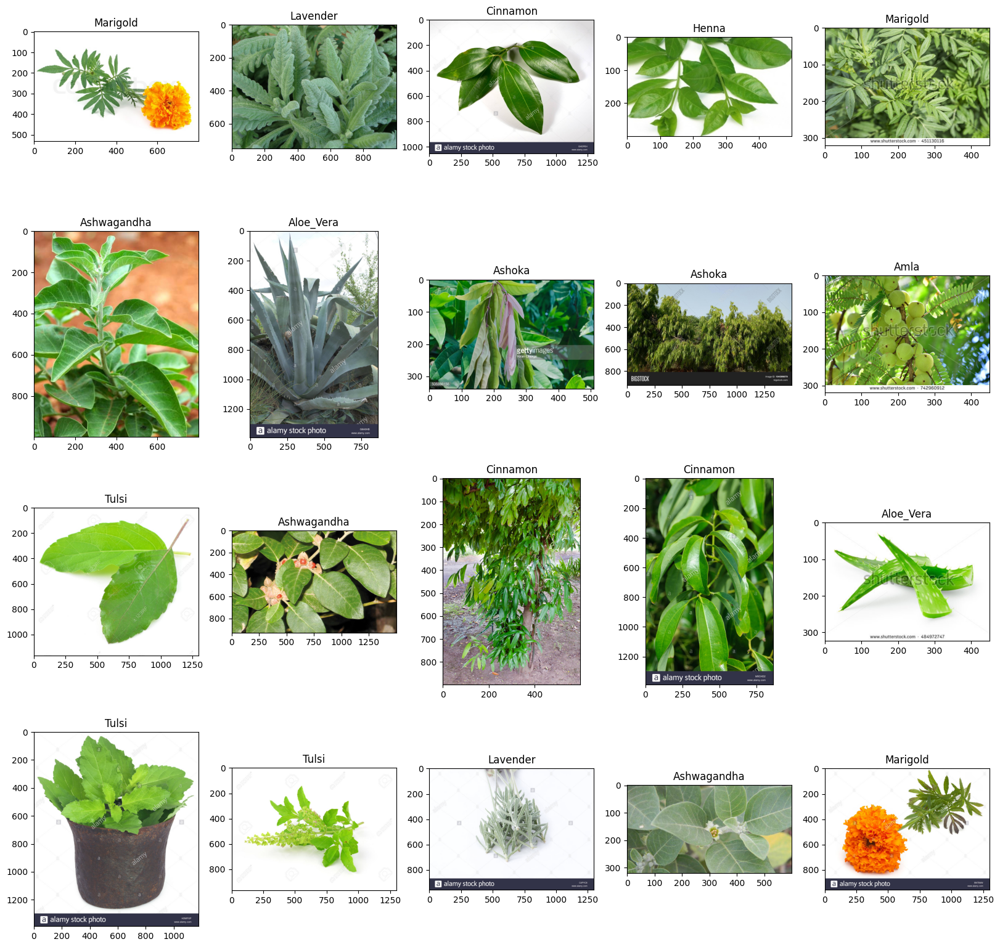

In [ ]:
import random
import os
import matplotlib.pyplot as mpimg

plt.figure(figsize=(20,20))
img_folder = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/training_dataset'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/training_dataset/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(directory_name)
  plt.imshow(img)
  plt.savefig('train-dataset.png')

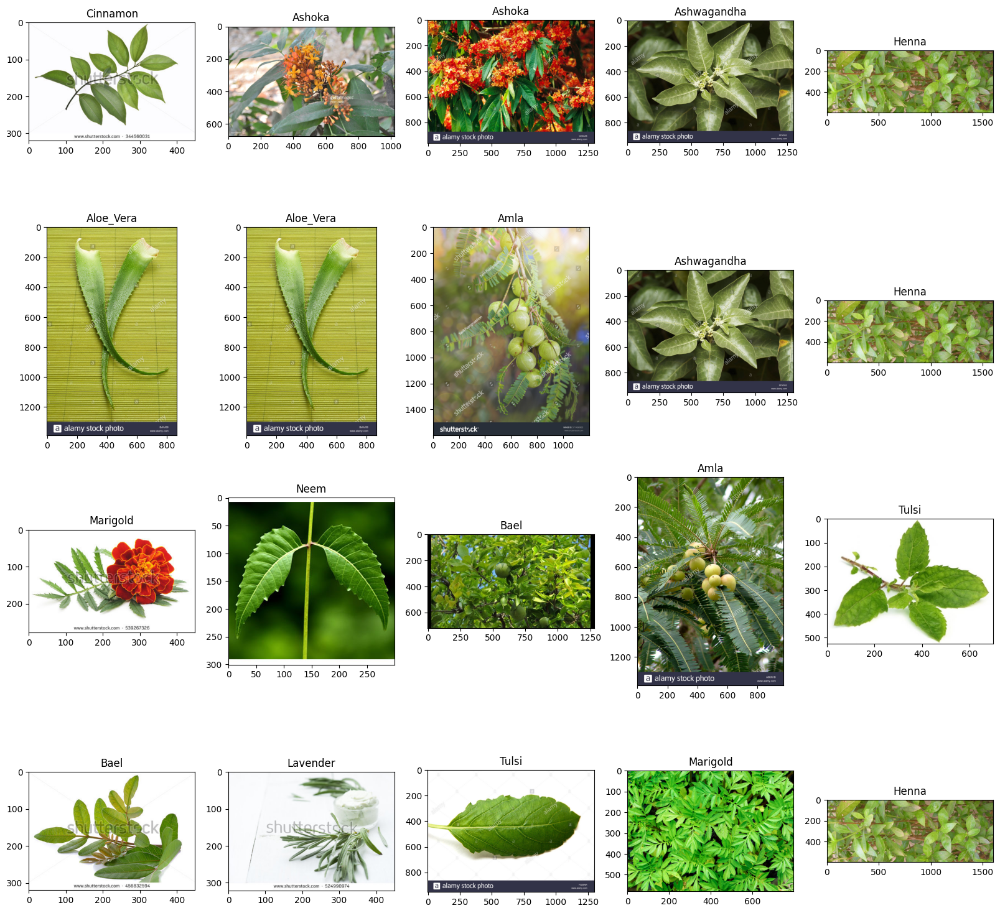

In [ ]:
plt.figure(figsize=(20,20))
img_folder = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(directory_name)
  plt.imshow(img)
  plt.savefig('test-dataset.png')

In [ ]:
from PIL import Image
from numpy import asarray
out=['Aloe_Vera',
 'Amla',
 'Ashoka',
 'Ashwagandha',
 'Bael',
 'Cinnamon',
 'Henna',
 'Lavender',
 'Marigold',
 'Neem',
 'Peppermint',
 'Tulsi',
 'Turmeric'
 ]



In [ ]:
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize=(20,20))
img_folder = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset'
for i in range(20):
  file = random.choice(os.listdir(img_folder))
  directory_name = file
  data = r'/home/atinsharma/CAPSTONE/MainProjectGit/Medicinal-Plant-Identification/testing_dataset/'+file
  file = random.choice(os.listdir(data))
  image_path = os.path.join(data, file)
  img = Image.open(image_path)
  img = img.resize((224,224))
  img = asarray(img)

  img=img/255.
  img_=img.reshape(1,224,224,3)

  res=model_new.predict(img_)
  print(res)
  
  img = mpimg.imread(image_path)
  ax = plt.subplot(4,5,i+1)
  ax.title.set_text(out[np.argmax(res)])
  plt.imshow(img)
  plt.savefig('predictions.png')

NameError: name 'model_new' is not defined

<Figure size 2000x2000 with 0 Axes>